In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
seed=42

In [3]:
from fastai import *
from fastai.vision import *
from fastai.callbacks.hooks import *
import scipy.ndimage

import gc

np.random.seed(seed)

PATH = Path('data_crop')

# reset learner
def reset_learner(data,is_fp16=False):
    learn=None
    gc.collect()
    learn = create_cnn(data, models.resnet50, metrics=accuracy)
    if is_fp16:
        learn = learn.to_fp16()
    return learn
def get_data(bs,size,tfms,valid_pct=0.15,path=PATH,seed=seed):
    np.random.seed(seed)
#     tfms = get_transforms(do_flip=True, max_rotate=5, max_zoom=1, max_lighting=0.2, max_warp=0,p_affine=0,p_lighting=0.75)
    return ImageDataBunch.from_folder(path,train='train',valid_pct=valid_pct,bs=bs,ds_tfms = tfms,size=size,num_workers=4).normalize(imagenet_stats)

def hooked_backward(m,xb,target_layer,clas):
    with hook_output(target_layer) as hook_a: #hook at last layer of group 0's output (after bn, size 512x7x7 if resnet34)
        with hook_output(target_layer, grad=True) as hook_g: # gradient w.r.t to the target_layer
            preds = m(xb)
            preds[0,int(clas)].backward() # same as onehot backprop
    return hook_a,hook_g

def show_heatmap(hm,xb_im,ax=None,size=256):
    if ax is None:
        _,ax = plt.subplots()
    xb_im.show(ax)
    ax.imshow(hm, alpha=0.8, extent=(0,size,size,0),
              interpolation='bilinear');
def minmax_norm(x):
    return (x - np.min(x))/(np.max(x) - np.min(x))
def scaleup(x,size):
    scale_mult=size/x.shape[0]
    upsampled = scipy.ndimage.zoom(x, scale_mult)
    return upsampled

def get_grad_heatmap(xb,y,size=256,guided_bp=True):
    xb = xb.cuda()
    m = learn.model.eval();
    target_layer = m[0][-1][-1] # last layer of group 0
    hook_a,hook_g = hooked_backward(m,xb,target_layer,y)
    
    target_act= hook_a.stored[0].cpu().numpy() #single
    target_grad = hook_g.stored[0][0].cpu().numpy() #single
    
    mean_grad = target_grad.mean(1).mean(1) #(512,)
    hmap = (target_act*mean_grad[...,None,None]).mean(0) #(7,7)
    
    # sum method. Same effect
#     sum_grad = target_grad.sum(1).sum(1)
#     hmap = np.maximum(0, np.einsum('i, ijk',sum_grad, target_act))
    
    xb_grad=None
    if guided_bp:
        xb_grad = guided_backprop(xb,y) # (3,224,224)        
        #minmax norm the grad
        xb_grad = minmax_norm(xb_grad)
        hmap_scaleup = minmax_norm(scaleup(hmap,size)) # (224,224)
        # multiply xb_grad*hmap_scaleup and switch axis
        xb_grad = np.einsum('ijk, jk->jki',xb_grad, hmap_scaleup) #(224,224,3)
    
    return hmap,xb_grad


def clamp_gradients_hook(module, grad_in, grad_out):
    for grad in grad_in:
        torch.clamp_(grad, min=0.0)
def hook_ReLU(m,xb,clas):
    relu_modules = [module[1] for module in m.named_modules() if str(module[1]) == "ReLU(inplace)"]
    with callbacks.Hooks(relu_modules, clamp_gradients_hook, is_forward=False) as _:
        preds = m(xb)
        preds[0,int(clas)].backward()
def guided_backprop(xb,y):
    xb = xb.cuda()
    m = learn.model.eval();
    xb.requires_grad_();
    if not xb.grad is None:
        xb.grad.zero_(); 
    hook_ReLU(m,xb,y);
    return xb.grad[0].cpu().numpy()
    

# Find good data augmentation

In [21]:
tfms = get_transforms(do_flip=True, 
                      max_rotate=5, 
                      max_zoom=1.05, 
                      max_lighting=0.3, 
                      max_warp=0,
                      p_affine=0.75,
                      p_lighting=0.8)
tfms[0]

[RandTransform(tfm=TfmCrop (crop_pad), kwargs={'row_pct': (0, 1), 'col_pct': (0, 1)}, p=1.0, resolved={}, do_run=True, is_random=True),
 RandTransform(tfm=TfmAffine (flip_affine), kwargs={}, p=0.5, resolved={}, do_run=True, is_random=True),
 RandTransform(tfm=TfmAffine (rotate), kwargs={'degrees': (-5, 5)}, p=0.75, resolved={}, do_run=True, is_random=True),
 RandTransform(tfm=TfmAffine (zoom), kwargs={'row_pct': (0, 1), 'col_pct': (0, 1), 'scale': (1.0, 1.05)}, p=0.75, resolved={}, do_run=True, is_random=True),
 RandTransform(tfm=TfmLighting (brightness), kwargs={'change': (0.35, 0.65)}, p=0.8, resolved={}, do_run=True, is_random=True),
 RandTransform(tfm=TfmLighting (contrast), kwargs={'scale': (0.7, 1.4285714285714286)}, p=0.8, resolved={}, do_run=True, is_random=True)]

In [5]:
tfms[1] #validation transformation

[RandTransform(tfm=TfmCrop (crop_pad), kwargs={}, p=1.0, resolved={}, do_run=True, is_random=True)]

In [ ]:
np.random.seed(seed)
data = ImageDataBunch.from_folder(PATH,
                                  train='train',
#                                   ds_tfms=(temp_tfms, []),
                                  bs=80,
                                  size=300,num_workers=4).normalize(imagenet_stats)
ds = data.train_ds

In [25]:
idxs=np.random.permutation(len(ds))[:10]

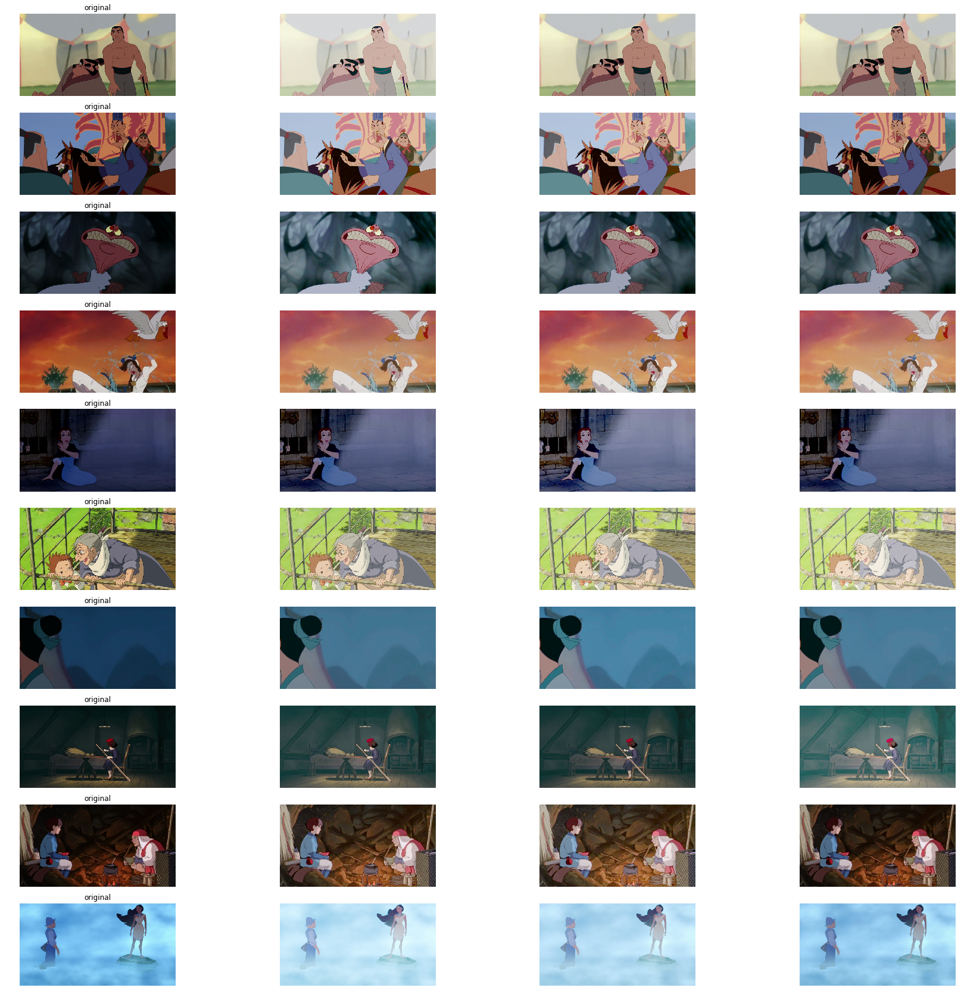

In [26]:
# lower contrast higher brightness -> good (background is visible)
temp_tfms = [contrast(scale=(0.7,0.9)),brightness(change=(0.6,0.8))]

fig,axes = plt.subplots(len(idxs),4,figsize=(30,len(idxs)*3))
for i,idx in enumerate(idxs):
    ds[idx][0].apply_tfms([]).show(axes[i][0],title='original')
    for ax in axes[i][1:]:
        im=ds[idx][0].apply_tfms(temp_tfms)
        im.show(ax)

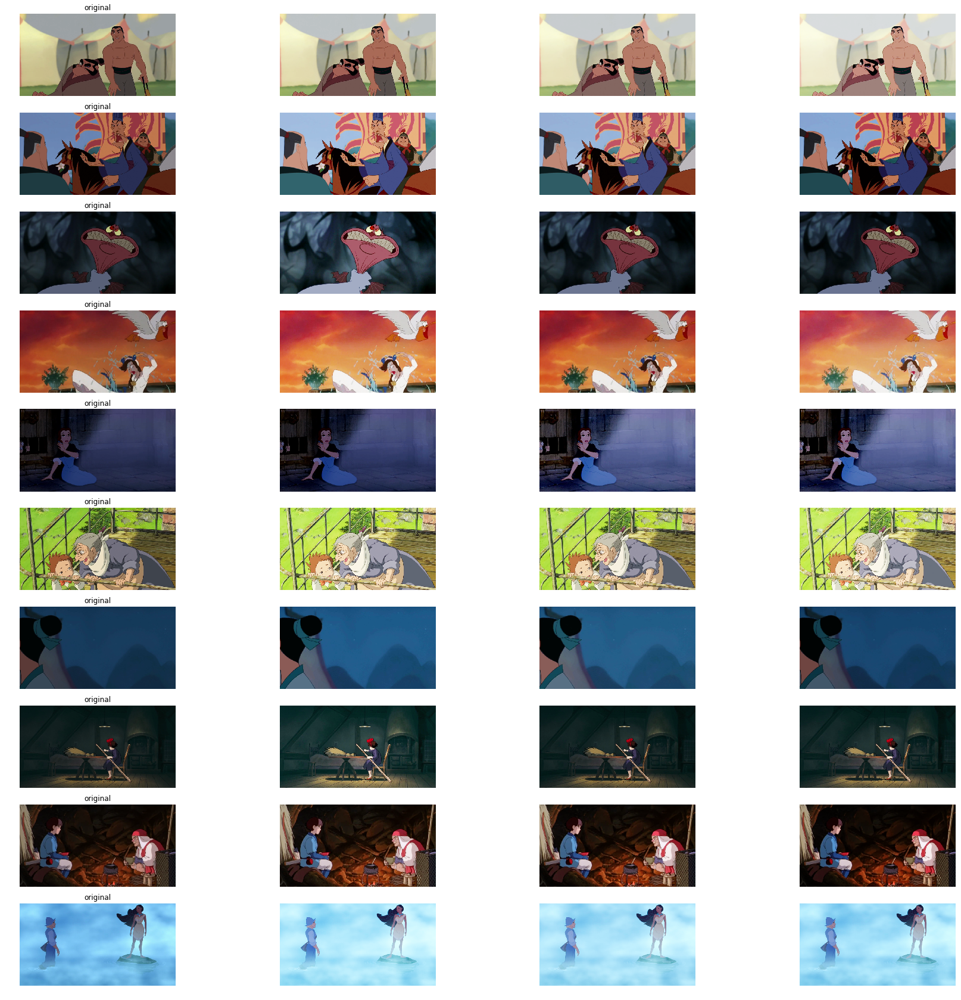

In [27]:
# higher contrast higher brightness -> ?
temp_tfms = [contrast(scale=(1.1,1.3)),brightness(change=(0.6,0.8))]

fig,axes = plt.subplots(len(idxs),4,figsize=(30,len(idxs)*3))
for i,idx in enumerate(idxs):
    ds[idx][0].apply_tfms([]).show(axes[i][0],title='original')
    for ax in axes[i][1:]:
        im=ds[idx][0].apply_tfms(temp_tfms)
        im.show(ax)

TODO: always set high brighness!
```
RandTransform(tfm=TfmLighting (brightness), kwargs={'change': (0.6,0.8)}, p=0.8, resolved={}, do_run=True, is_random=True),
 RandTransform(tfm=TfmLighting (contrast), kwargs={'scale': (0.7, 1.4285714285714286)}, p=0.8, resolved={}, do_run=True, is_random=True)]
 ```

In [37]:
temp_tfms = [crop_pad(size=300, padding_mode='reflection', row_pct=(0,1), col_pct=(0,1))]
data = ImageDataBunch.from_folder(PATH,
                                  train='train',
                                  ds_tfms=(temp_tfms, []),
                                  bs=80,
                                  size=300,num_workers=4).normalize(imagenet_stats)
ds = data.train_ds

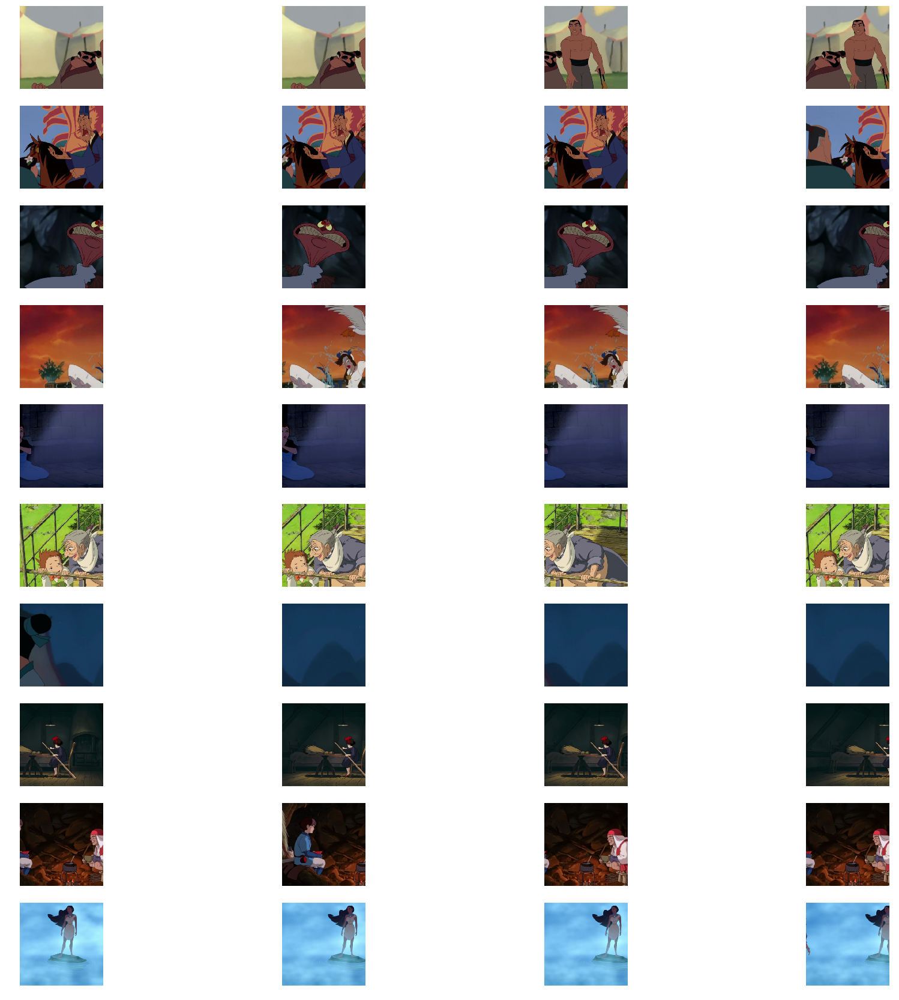

In [40]:
fig,axes = plt.subplots(len(idxs),4,figsize=(30,len(idxs)*3))
for i,idx in enumerate(idxs):
    for ax in axes[i][:]:
        im=ds[idx][0].apply_tfms(temp_tfms)
        im.show(ax)

# Start training

In [15]:
tfms = get_transforms(do_flip=True, 
                      max_rotate=5, 
                      max_zoom=1.1, 
                      max_lighting=0.25, 
                      max_warp=0,
                      p_affine=0.7,
                      p_lighting=0.8)

In [16]:
data=None
gc.collect()
data = get_data(80,300,tfms,0.1)
learn= reset_learner(data,is_fp16=True)

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


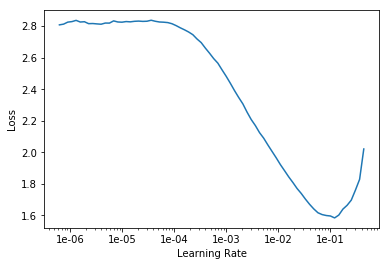

In [67]:
learn.freeze()
learn.lr_find()
learn.recorder.plot()

In [7]:
learn.freeze()
learn.fit_one_cycle(8,max_lr=8e-03)

epoch,train_loss,valid_loss,accuracy
1,0.214012,0.192933,0.935007
2,0.251694,0.456302,0.860601
3,0.193878,0.611905,0.817122
4,0.160004,0.185102,0.938593
5,0.104085,0.069863,0.974899
6,0.064495,0.034839,0.990139
7,0.041963,0.024889,0.992828
8,0.031920,0.017726,0.995070


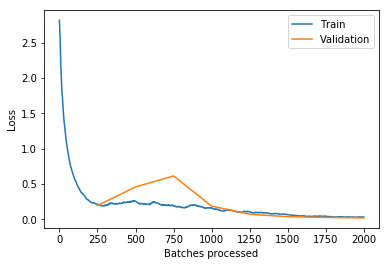

In [8]:
learn.recorder.plot_losses()

In [9]:
# learn.save(f'stage1-300-8epochs')

## stage 2

In [11]:
# tfms = get_transforms(do_flip=True, 
#                       max_rotate=5, 
#                       max_zoom=1.1, 
#                       max_lighting=0.25, 
#                       max_warp=0,
#                       p_affine=0.7,
#                       p_lighting=0.8)

data=None
gc.collect()
data = get_data(64,300,tfms,0.1)
learn= reset_learner(data,is_fp16=True)

In [12]:
learn.load(f'stage1-300-8epochs');

In [13]:
learn.unfreeze()
learn.fit_one_cycle(1,max_lr=slice(1e-05))

epoch,train_loss,valid_loss,accuracy
1,0.027072,0.016827,0.995070


In [28]:
# learn.save(f'stage2-300-1epoch');

# Interpretation

In [32]:
tfms = get_transforms(do_flip=True, 
                      max_rotate=5, 
                      max_zoom=1.1, 
                      max_lighting=0.25, 
                      max_warp=0,
                      p_affine=0.7,
                      p_lighting=0.8)
data=None
gc.collect()
data = get_data(64,300,tfms,0.1)
learn= reset_learner(data)
learn.load('stage2-300-1epoch');

In [33]:
# learn.data.valid_dl.add_tfm(to_half)

interp = ClassificationInterpretation.from_learner(learn)

In [ ]:
# interp.plot_top_losses(25, figsize=(20,20))

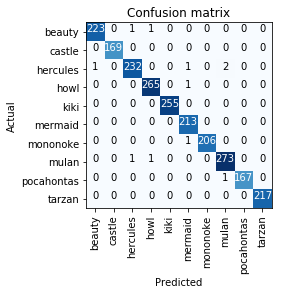

In [35]:
interp.plot_confusion_matrix()

# Grad CAM and guided backprop

In [10]:
def plot_gradcam_guidedbp(res):
    fig,axes =plt.subplots(len(res),3,figsize=(15,len(res)*4))
    for i,(xb_img,y,hmap,xb_grad) in enumerate(res):
        xb_img.show(axes[i][0],title=data.classes[y])
        show_heatmap(hmap,xb_img,axes[i][1],size=300)
        axes[i][2].imshow(xb_grad)
        axes[i][2].set_axis_off()

In [36]:
it = iter(learn.data.valid_dl)

In [43]:
imgs, labels = next(it)

In [48]:
%%time
res = []
s=40
e=s+20
for x,y in zip(imgs[s:e],labels[s:e]):
    xb = x[None,...]
    xb_img= Image(data.denorm(xb)[0])
    hmap,xb_grad = get_grad_heatmap(xb,y,size=300)
    res.append((xb_img,y,hmap,xb_grad))

CPU times: user 3.53 s, sys: 224 ms, total: 3.76 s
Wall time: 978 ms


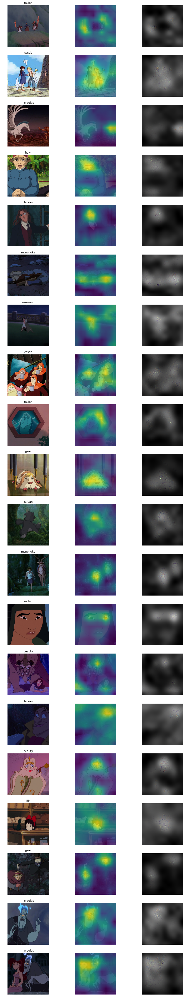

In [49]:
plot_gradcam_guidedbp(res)

# Testing with real images

In [4]:
bs=64
size=300

In [5]:
tfms = get_transforms(do_flip=True, 
                      max_rotate=5, 
                      max_zoom=1.1, 
                      max_lighting=0.25, 
                      max_warp=0,
                      p_affine=0.7,
                      p_lighting=0.8)
data=None
gc.collect()
data= ImageDataBunch.from_folder(PATH,train='train',valid='val',bs=bs,ds_tfms = tfms,size=size,num_workers=4).normalize(imagenet_stats)
learn= reset_learner(data)
learn.load('stage1-300-8epochs');

In [6]:
interp = ClassificationInterpretation.from_learner(learn)

In [7]:
accuracy(interp.probs,torch.tensor(data.valid_ds.y.items))

tensor(0.2720)

In [8]:
len(data.valid_ds)

125

In [9]:
col=3
row=int(len(data.valid_ds)/col+1)
row,col

(42, 3)

In [ ]:
it = iter(learn.data.valid_dl)

In [ ]:
imgs, labels = next(it)
res = []
s=0
e=len(imgs)
for x,y in zip(imgs[s:e],labels[s:e]):
    xb = x[None,...]
    xb_img= Image(data.denorm(xb)[0])
    hmap,xb_grad = get_grad_heatmap(xb,y,size=300)
    res.append((xb_img,y,hmap,xb_grad))

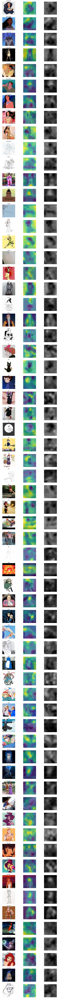

In [18]:
plot_gradcam_guidedbp(res)